In [1]:
import tensorflow as tf
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline
from tensorflow import keras
from tensorflow.keras import layers
from tensorflow.keras.layers import Normalization, Dense, InputLayer
from tensorflow.keras.losses import MeanSquaredError, Huber, MeanAbsoluteError
from tensorflow.keras.metrics import RootMeanSquaredError
from tensorflow.keras.optimizers import Adam
import jovian

In [2]:
data = pd.read_csv("car price prediction.csv")
data

,v.id,on road old,on road now,years,km,rating,condition,economy,top speed,hp,torque,current price
0,1,535651,798186,3,78945,1,2,14,177,73,123,351318.0
1,2,591911,861056,6,117220,5,9,9,148,74,95,285001.5
2,3,686990,770762,2,132538,2,8,15,181,53,97,215386.0
3,4,573999,722381,4,101065,4,3,11,197,54,116,244295.5
4,5,691388,811335,6,61559,3,9,12,160,53,105,531114.5
...,...,...,...,...,...,...,...,...,...,...,...,...
995,996,633238,743850,5,125092,1,6,11,171,95,97,190744.0
996,997,599626,848195,4,83370,2,9,14,161,101,120,419748.0
997,998,646344,842733,7,86722,1,8,9,196,113,89,405871.0
998,999,535559,732439,2,140478,4,5,9,184,112,128,74398.0


In [3]:
data.shape

(1000, 12)

In [4]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1000 entries, 0 to 999
Data columns (total 12 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   v.id           1000 non-null   int64  
 1   on road old    1000 non-null   int64  
 2   on road now    1000 non-null   int64  
 3   years          1000 non-null   int64  
 4   km             1000 non-null   int64  
 5   rating         1000 non-null   int64  
 6   condition      1000 non-null   int64  
 7   economy        1000 non-null   int64  
 8   top speed      1000 non-null   int64  
 9   hp             1000 non-null   int64  
 10  torque         1000 non-null   int64  
 11  current price  1000 non-null   float64
dtypes: float64(1), int64(11)
memory usage: 93.9 KB


In [5]:
round(data.describe().T)

,count,mean,std,min,25%,50%,75%,max
v.id,1000.0,500.0,289.0,1.0,251.0,500.0,750.0,1000.0
on road old,1000.0,601648.0,58407.0,500265.0,548860.0,601568.0,652267.0,699859.0
on road now,1000.0,799131.0,57029.0,700018.0,750998.0,798168.0,847563.0,899797.0
years,1000.0,5.0,2.0,2.0,3.0,5.0,6.0,7.0
km,1000.0,100274.0,29150.0,50324.0,74368.0,100140.0,125048.0,149902.0
rating,1000.0,3.0,1.0,1.0,2.0,3.0,4.0,5.0
condition,1000.0,6.0,3.0,1.0,3.0,6.0,8.0,10.0
economy,1000.0,12.0,2.0,8.0,10.0,12.0,13.0,15.0
top speed,1000.0,167.0,19.0,135.0,150.0,166.0,184.0,200.0
hp,1000.0,85.0,21.0,50.0,67.0,84.0,102.0,120.0


In [6]:
data.columns

Index(['v.id', 'on road old', 'on road now', 'years', 'km', 'rating',
       'condition', 'economy', 'top speed', 'hp', 'torque', 'current price'],
      dtype='object')

In [7]:
data.corr()['current price'].sort_values(ascending=False)

current price    1.000000
on road now      0.282793
on road old      0.233035
condition        0.110108
rating           0.035038
hp               0.030238
torque          -0.002290
years           -0.011854
top speed       -0.027993
economy         -0.034711
v.id            -0.059460
km              -0.935924
Name: current price, dtype: float64

In [8]:
from ydata_profiling import ProfileReport
profile=ProfileReport(data, explorative=True)
profile

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [9]:
import numpy as np

# Define the summary statistics
means = np.array([500.0, 601648.0, 799131.0, 5.0, 100274.0, 3.0, 6.0, 12.0, 167.0, 85.0, 103.0, 308520.0])
stds = np.array([289.0, 58407.0, 57029.0, 2.0, 29150.0, 1.0, 3.0, 2.0, 19.0, 21.0, 21.0, 126073.0])

# Calculate the variance (square of standard deviation)
variances = stds ** 2

# Print the mean and variance for each feature
for i, (mean, variance) in enumerate(zip(means, variances), start=1):
    print(f"Feature {i}: Mean={mean}, Variance={variance}")

Feature 1: Mean=500.0, Variance=83521.0
Feature 2: Mean=601648.0, Variance=3411377649.0
Feature 3: Mean=799131.0, Variance=3252306841.0
Feature 4: Mean=5.0, Variance=4.0
Feature 5: Mean=100274.0, Variance=849722500.0
Feature 6: Mean=3.0, Variance=1.0
Feature 7: Mean=6.0, Variance=9.0
Feature 8: Mean=12.0, Variance=4.0
Feature 9: Mean=167.0, Variance=361.0
Feature 10: Mean=85.0, Variance=441.0
Feature 11: Mean=103.0, Variance=441.0
Feature 12: Mean=308520.0, Variance=15894401329.0


D:\New folder\anaconda\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


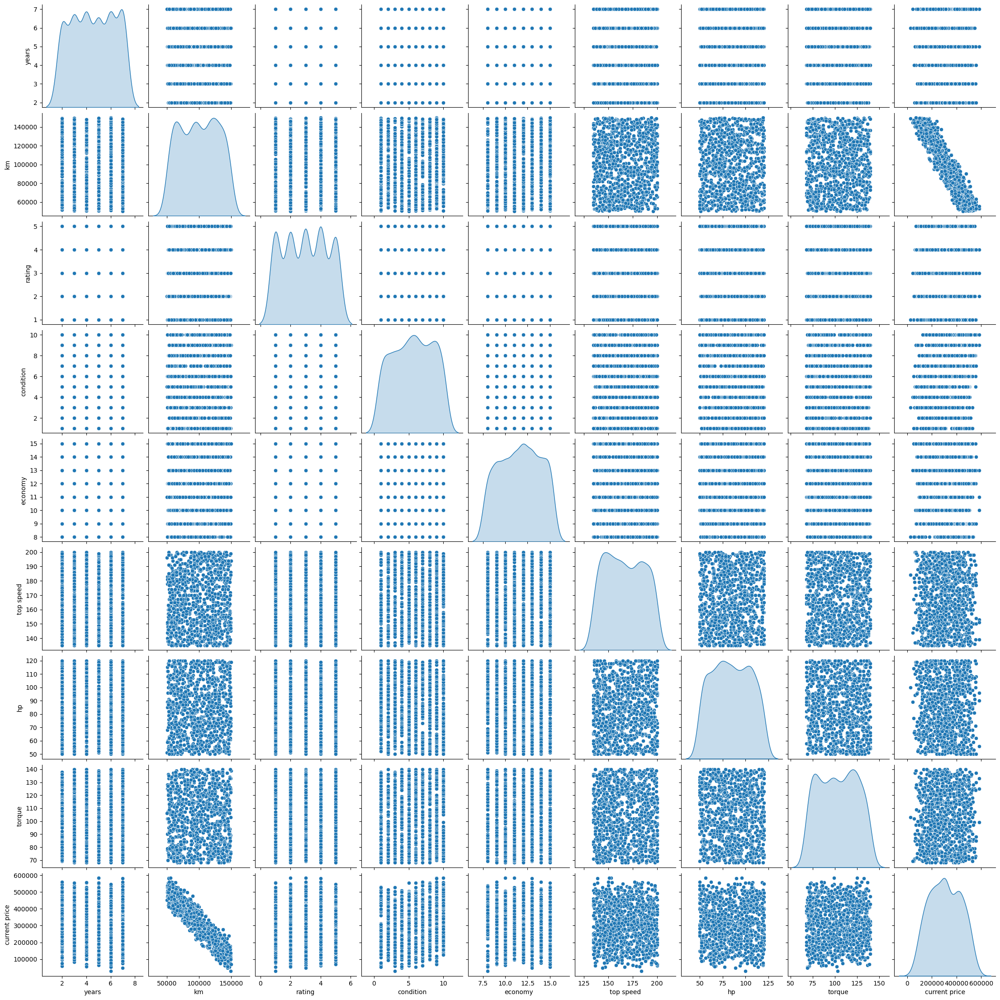

In [10]:
g=sns.pairplot(data[['years', 'km', 'rating', 'condition', 'economy', 'top speed', 'hp', 'torque', 'current price']], diag_kind='kde')

In [11]:
tensor_data=tf.constant(data) #convert the data into tensor
tensor_data=tf.cast(tensor_data, tf.float32) # changed the data type
print(tensor_data)

tf.Tensor(
[[1.000000e+00 5.356510e+05 7.981860e+05 ... 7.300000e+01 1.230000e+02
  3.513180e+05]
 [2.000000e+00 5.919110e+05 8.610560e+05 ... 7.400000e+01 9.500000e+01
  2.850015e+05]
 [3.000000e+00 6.869900e+05 7.707620e+05 ... 5.300000e+01 9.700000e+01
  2.153860e+05]
 ...
 [9.980000e+02 6.463440e+05 8.427330e+05 ... 1.130000e+02 8.900000e+01
  4.058710e+05]
 [9.990000e+02 5.355590e+05 7.324390e+05 ... 1.120000e+02 1.280000e+02
  7.439800e+04]
 [1.000000e+03 5.901050e+05 7.797430e+05 ... 9.900000e+01 9.600000e+01
  4.149385e+05]], shape=(1000, 12), dtype=float32)


In [12]:
tensor_data = tf.random.shuffle(tensor_data)
print(tensor_data[:5])

tf.Tensor(
[[9.220000e+02 5.579620e+05 8.525730e+05 3.000000e+00 7.088800e+04
  3.000000e+00 5.000000e+00 1.500000e+01 1.890000e+02 8.900000e+01
  1.090000e+02 4.235840e+05]
 [3.430000e+02 5.962360e+05 8.401870e+05 4.000000e+00 9.438800e+04
  2.000000e+00 6.000000e+00 1.500000e+01 1.620000e+02 6.500000e+01
  1.240000e+02 3.443395e+05]
 [9.370000e+02 6.723490e+05 8.784580e+05 3.000000e+00 1.218920e+05
  2.000000e+00 8.000000e+00 1.100000e+01 1.740000e+02 5.200000e+01
  1.330000e+02 3.043540e+05]
 [7.210000e+02 5.377380e+05 8.230310e+05 2.000000e+00 1.158700e+05
  3.000000e+00 6.000000e+00 1.200000e+01 1.370000e+02 7.700000e+01
  1.110000e+02 2.211325e+05]
 [8.090000e+02 6.405090e+05 7.498930e+05 5.000000e+00 1.434100e+05
  1.000000e+00 7.000000e+00 9.000000e+00 1.790000e+02 8.000000e+01
  1.200000e+02 1.286325e+05]], shape=(5, 12), dtype=float32)


ডেটা shuffle করা অনেক কারণেই গুরুত্বপূর্ণ, বিশেষত মেশিন লার্নিং এবং ডিপ লার্নিং মডেলের প্রশিক্ষণের (training) ক্ষেত্রে:

Bias (পক্ষপাতিত্ব) কমানো: ডেটাসেটের মধ্যে ধারাবাহিকতা বা প্যাটার্ন থাকলে, মডেল প্রশিক্ষণের সময় এই প্যাটার্ন থেকে শিখতে পারে, যা মডেলের জেনারালাইজেশন ক্ষমতাকে প্রভাবিত করতে পারে। ডেটা shuffle করার মাধ্যমে এই ধরনের পক্ষপাতিত্ব দূর করা যায়।

Model Generalization (মডেলের সাধারণীকরণ): মডেলকে ডেটাসেটের বিভিন্ন অংশ থেকে শিখতে সাহায্য করে, যা মডেলকে নতুন এবং অজানা ডেটার ক্ষেত্রে ভালো পারফর্ম করতে সাহায্য করে।

Batch Gradient Descent: যদি ট্রেনিং প্রক্রিয়াতে ব্যাচ গ্রেডিয়েন্ট ডিসেন্ট ব্যবহৃত হয়, তাহলে প্রতিটি ব্যাচে থাকা ডেটা এলোমেলো হলে মডেল ভালোভাবে কনভার্জ করতে পারে। যদি ডেটা এলোমেলো না করা হয়, তাহলে এক ধরনের ডেটা নিয়ে কাজ করা শেষে অন্য ধরনের ডেটা নিয়ে কাজ করা হতে পারে, যা মডেলের পারফরম্যান্সের উপর নেতিবাচক প্রভাব ফেলতে পারে।

In [13]:
X = tensor_data[:,3:-1] #x for input
print(X[:5])

tf.Tensor(
[[3.00000e+00 7.08880e+04 3.00000e+00 5.00000e+00 1.50000e+01 1.89000e+02
  8.90000e+01 1.09000e+02]
 [4.00000e+00 9.43880e+04 2.00000e+00 6.00000e+00 1.50000e+01 1.62000e+02
  6.50000e+01 1.24000e+02]
 [3.00000e+00 1.21892e+05 2.00000e+00 8.00000e+00 1.10000e+01 1.74000e+02
  5.20000e+01 1.33000e+02]
 [2.00000e+00 1.15870e+05 3.00000e+00 6.00000e+00 1.20000e+01 1.37000e+02
  7.70000e+01 1.11000e+02]
 [5.00000e+00 1.43410e+05 1.00000e+00 7.00000e+00 9.00000e+00 1.79000e+02
  8.00000e+01 1.20000e+02]], shape=(5, 8), dtype=float32)


In [14]:
y = tensor_data[:,-1] #for output
print(y[:5].shape)
y = tf.expand_dims(y, axis = -1) #expend dim=expand Dimention
print(y[:5]) 

(5,)
tf.Tensor(
[[423584. ]
 [344339.5]
 [304354. ]
 [221132.5]
 [128632.5]], shape=(5, 1), dtype=float32)


In [15]:
print(X.shape)

(1000, 8)


In [16]:
TRAIN_RATIO = .8
VAL_RATIO = .1
TEST_RATIO = .1
DATASET_SIZE = len(X)

In [17]:
X_train = X[:int(DATASET_SIZE*TRAIN_RATIO)]
y_train = y[:int(DATASET_SIZE*TRAIN_RATIO)]
print(X_train.shape)
print(y_train.shape)

(800, 8)
(800, 1)


In [18]:
X_val = X[int(DATASET_SIZE*TRAIN_RATIO):int(DATASET_SIZE*(TRAIN_RATIO+VAL_RATIO))]
y_val = y[int(DATASET_SIZE*TRAIN_RATIO):int(DATASET_SIZE*(TRAIN_RATIO+VAL_RATIO))]
print(X_val.shape)
print(y_val.shape)


#val_dataset = train_dataset.shuffle(buffer_size = 8, reshuffle_each_iteration = True).batch(32).prefetch(tf.data.AUTOTUNE)

(100, 8)
(100, 1)


In [19]:
X_test = X[int(DATASET_SIZE*(TRAIN_RATIO+VAL_RATIO)):]
y_test = y[int(DATASET_SIZE*(TRAIN_RATIO+VAL_RATIO)):]
print(X_test.shape)
print(y_test.shape)

(100, 8)
(100, 1)


In [78]:
train_dataset = tf.data.Dataset.from_tensor_slices((X_train, y_train))
train_dataset = train_dataset.shuffle(buffer_size=512, reshuffle_each_iteration=True).batch(32).prefetch(tf.data.AUTOTUNE)

val_dataset = tf.data.Dataset.from_tensor_slices((X_val, y_val))
val_dataset = val_dataset.batch(32).prefetch(tf.data.AUTOTUNE)

test_dataset = tf.data.Dataset.from_tensor_slices((X_test, y_test))
test_dataset = test_dataset.batch(32).prefetch(tf.data.AUTOTUNE)

In [79]:
for x,y in train_dataset:
    print(x,y)   

tf.Tensor(
[[4.00000e+00 9.93200e+04 3.00000e+00 8.00000e+00 1.30000e+01 1.61000e+02
  7.60000e+01 1.13000e+02]
 [5.00000e+00 1.20623e+05 1.00000e+00 4.00000e+00 1.40000e+01 1.72000e+02
  8.50000e+01 1.33000e+02]
 [4.00000e+00 1.21583e+05 4.00000e+00 4.00000e+00 1.00000e+01 1.96000e+02
  1.08000e+02 1.08000e+02]
 [2.00000e+00 8.97380e+04 1.00000e+00 9.00000e+00 1.50000e+01 1.87000e+02
  8.10000e+01 1.14000e+02]
 [7.00000e+00 1.10122e+05 3.00000e+00 1.00000e+01 9.00000e+00 1.95000e+02
  6.70000e+01 1.32000e+02]
 [7.00000e+00 7.27300e+04 1.00000e+00 9.00000e+00 1.10000e+01 1.83000e+02
  9.40000e+01 7.30000e+01]
 [7.00000e+00 7.15710e+04 1.00000e+00 2.00000e+00 1.40000e+01 1.36000e+02
  5.00000e+01 1.00000e+02]
 [7.00000e+00 5.32310e+04 4.00000e+00 9.00000e+00 9.00000e+00 1.77000e+02
  6.20000e+01 8.50000e+01]
 [6.00000e+00 1.25638e+05 1.00000e+00 9.00000e+00 1.50000e+01 1.43000e+02
  1.01000e+02 9.40000e+01]
 [2.00000e+00 1.32059e+05 2.00000e+00 8.00000e+00 1.30000e+01 1.50000e+02
  8.70

In [80]:
normalizer=Normalization()
normalizer.adapt(X)
normalizer(X)[:5]

<tf.Tensor: shape=(5, 8), dtype=float32, numpy=
array([[-0.90849847, -1.0085993 ,  0.00855871, -0.20970328,  1.5138373 ,
         1.1467038 ,  0.21719764,  0.26496363],
       [-0.32650068, -0.20203368, -0.7046622 ,  0.14452523,  1.5138373 ,
        -0.2538033 , -0.9531527 ,  0.9776141 ],
       [-0.90849847,  0.74195695, -0.7046622 ,  0.8529823 , -0.28034025,
         0.36864433, -1.5870925 ,  1.4052044 ],
       [-1.4904962 ,  0.5352702 ,  0.00855871,  0.14452523,  0.16820414,
        -1.5505692 , -0.36797756,  0.35998368],
       [ 0.2554971 ,  1.4804964 , -1.4178832 ,  0.49875376, -1.177429  ,
         0.6279975 , -0.22168376,  0.787574  ]], dtype=float32)>

In [81]:
print(X[:5])

tf.Tensor(
[[3.00000e+00 7.08880e+04 3.00000e+00 5.00000e+00 1.50000e+01 1.89000e+02
  8.90000e+01 1.09000e+02]
 [4.00000e+00 9.43880e+04 2.00000e+00 6.00000e+00 1.50000e+01 1.62000e+02
  6.50000e+01 1.24000e+02]
 [3.00000e+00 1.21892e+05 2.00000e+00 8.00000e+00 1.10000e+01 1.74000e+02
  5.20000e+01 1.33000e+02]
 [2.00000e+00 1.15870e+05 3.00000e+00 6.00000e+00 1.20000e+01 1.37000e+02
  7.70000e+01 1.11000e+02]
 [5.00000e+00 1.43410e+05 1.00000e+00 7.00000e+00 9.00000e+00 1.79000e+02
  8.00000e+01 1.20000e+02]], shape=(5, 8), dtype=float32)


In [82]:
model = tf.keras.Sequential([
    InputLayer(shape=(8,)),
    normalizer,
    Dense(128, activation="relu"),
    Dense(128, activation="relu"),
    Dense(128, activation="relu"),
    Dense(1)
])
model.summary()

Model: "sequential_5"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ normalization_2 (Normalization)      │ (None, 8)                   │              17 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_23 (Dense)                     │ (None, 128)                 │           1,152 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_24 (Dense)                     │ (None, 128)                 │          16,512 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_25 (Dense)                     │ (None, 128)                 │          16,512 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_26 (Dense)                     │ (None, 1)                   │             129 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 34,322 (134.07 KB)

 Trainable params: 34,305 (134.00 KB)

 Non-trainable params: 17 (72.00 B)

In [83]:
model.compile(optimizer=Adam(learning_rate=0.1),
              loss=MeanAbsoluteError(),
              metrics=[RootMeanSquaredError()])

In [84]:
history = model.fit(
    train_dataset,            # The training dataset
    validation_data=val_dataset,  # The validation dataset
    epochs=100,                # Number of epochs
    verbose=1                  # Verbosity mode
)

Epoch 1/100
25/25 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - loss: 231546.9062 - root_mean_squared_error: 268823.4375 - val_loss: 65749.1875 - val_root_mean_squared_error: 75499.2500
Epoch 2/100
25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - loss: 52396.8438 - root_mean_squared_error: 64864.7109 - val_loss: 57990.2383 - val_root_mean_squared_error: 58830.7188
Epoch 3/100
25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - loss: 46252.0508 - root_mean_squared_error: 57558.4688 - val_loss: 45584.6289 - val_root_mean_squared_error: 51574.6133
Epoch 4/100
25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - loss: 45822.8789 - root_mean_squared_error: 56837.4414 - val_loss: 68654.9062 - val_root_mean_squared_error: 79854.0391
Epoch 5/100
25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - loss: 53025.0234 - root_mean_squared_error: 65663.1172 - val_loss: 61478.9961 - val_root_mean_squared_error: 65201.2969
Epoch 6/100
25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - loss: 51733.4805 - root_mean_squared_error: 63520.3672 - val_loss: 40993.2617 - 

25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - loss: 31712.0586 - root_mean_squared_error: 40510.2578 - val_loss: 40493.2656 - val_root_mean_squared_error: 44303.7148
Epoch 80/100
25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - loss: 33127.0625 - root_mean_squared_error: 42248.6680 - val_loss: 39356.5312 - val_root_mean_squared_error: 47009.9062
Epoch 81/100
25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - loss: 34114.9297 - root_mean_squared_error: 43479.0742 - val_loss: 39610.6133 - val_root_mean_squared_error: 47180.5039
Epoch 82/100
25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - loss: 35172.2344 - root_mean_squared_error: 44090.1992 - val_loss: 39072.0859 - val_root_mean_squared_error: 45413.2227
Epoch 83/100
25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - loss: 33345.9883 - root_mean_squared_error: 41909.2383 - val_loss: 38828.1914 - val_root_mean_squared_error: 46542.5547
Epoch 84/100
25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - loss: 35531.3242 - root_mean_squared_error: 44531.9531 - val_loss: 36805.8164 - val_root_

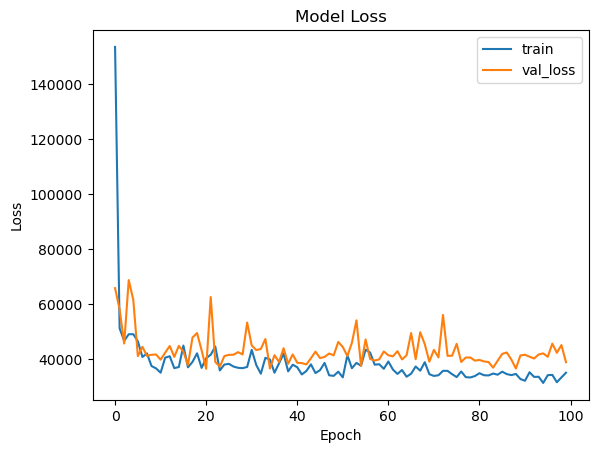

In [85]:
plt.plot(history.history['loss'], label='train')
plt.plot(history.history['val_loss'], label='val_loss')
plt.title('Model Loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend()
plt.show()

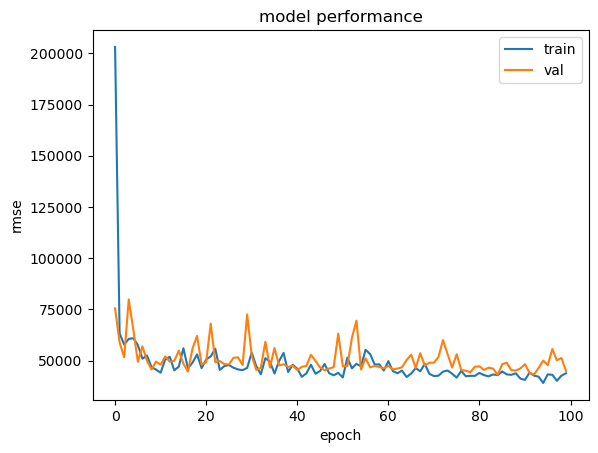

In [86]:
plt.plot(history.history['root_mean_squared_error'])
plt.plot(history.history['val_root_mean_squared_error'])
plt.title('model performance') 
plt.ylabel('rmse')
plt.xlabel('epoch')
plt.legend(['train', 'val'])
plt.show()

In [61]:
model.evaluate(X_test,y_test)

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - loss: 39324.9688 - root_mean_squared_error: 46412.4297 


[40227.41796875, 47324.4609375]

In [62]:
X_test.shape

TensorShape([100, 8])

In [63]:
model.predict(tf.expand_dims(X_test[0], axis=0))

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step


array([[335476.53]], dtype=float32)

In [64]:
y_test[0]

<tf.Tensor: shape=(1,), dtype=float32, numpy=array([293841.], dtype=float32)>

In [65]:
y_true=list(y_test[:,0].numpy())
y_true

[293841.0,
 439639.5,
 414938.5,
 224745.0,
 294502.5,
 419748.0,
 420403.0,
 253853.5,
 159647.0,
 197377.5,
 104215.0,
 324260.0,
 395188.0,
 371227.0,
 333278.0,
 327454.5,
 375118.0,
 492951.0,
 420401.0,
 413066.0,
 512492.0,
 197266.0,
 327075.5,
 239214.0,
 304923.5,
 108354.0,
 210777.5,
 291776.5,
 425083.5,
 221412.5,
 312469.0,
 283208.0,
 269326.0,
 317119.0,
 487717.0,
 506401.0,
 461900.5,
 353237.0,
 148491.0,
 356606.5,
 306745.5,
 179077.0,
 341328.0,
 240353.5,
 120583.5,
 261732.0,
 431060.0,
 188582.0,
 493806.5,
 55925.0,
 411701.0,
 366878.5,
 74863.0,
 306690.0,
 420083.0,
 372595.5,
 532570.5,
 332812.0,
 502519.0,
 338141.5,
 251317.5,
 90220.0,
 309455.0,
 400027.5,
 217562.0,
 362434.5,
 347784.5,
 380231.0,
 233139.0,
 377706.5,
 221510.0,
 97526.0,
 428602.5,
 435007.5,
 375097.5,
 477912.0,
 221692.0,
 289049.5,
 413288.0,
 417693.5,
 429669.0,
 405505.0,
 243565.5,
 293875.5,
 167794.0,
 419713.0,
 452931.0,
 337257.0,
 354722.0,
 76772.0,
 123719.5,
 931

In [68]:
y_pred=list(model.predict(X_test)[:,0])
print(y_pred)

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 678us/step
[335476.53, 362004.47, 416042.94, 178991.14, 324637.03, 366676.06, 401665.16, 335340.28, 182189.28, 191388.69, 88323.91, 334171.5, 341964.5, 344519.3, 285241.72, 351287.8, 394426.72, 423688.47, 408716.72, 379466.03, 466941.78, 119763.586, 375500.88, 216142.92, 295092.3, 95633.71, 246674.56, 263251.84, 456604.66, 261893.44, 342873.9, 197555.75, 335823.72, 326269.6, 542403.2, 511086.9, 470654.94, 334635.6, 211656.27, 423579.03, 345957.88, 124817.43, 316209.34, 183636.12, 158624.83, 276763.47, 414522.28, 174073.6, 418230.6, 135157.69, 398230.66, 382298.34, 173845.69, 357981.1, 374694.6, 311061.97, 463513.97, 359763.84, 439063.25, 377405.44, 256257.28, 149873.42, 277187.7, 293616.66, 258049.95, 264132.28, 333463.75, 334843.72, 279512.78, 393404.22, 235817.72, 180923.4, 377186.16, 409153.03, 358527.6, 417649.12, 209035.28, 305371.53, 422714.47, 504024.94, 472858.28, 433403.1, 242523.1, 339802.06, 108974.78, 382152.78, 435027.47, 289397.84, 296604.78, 1

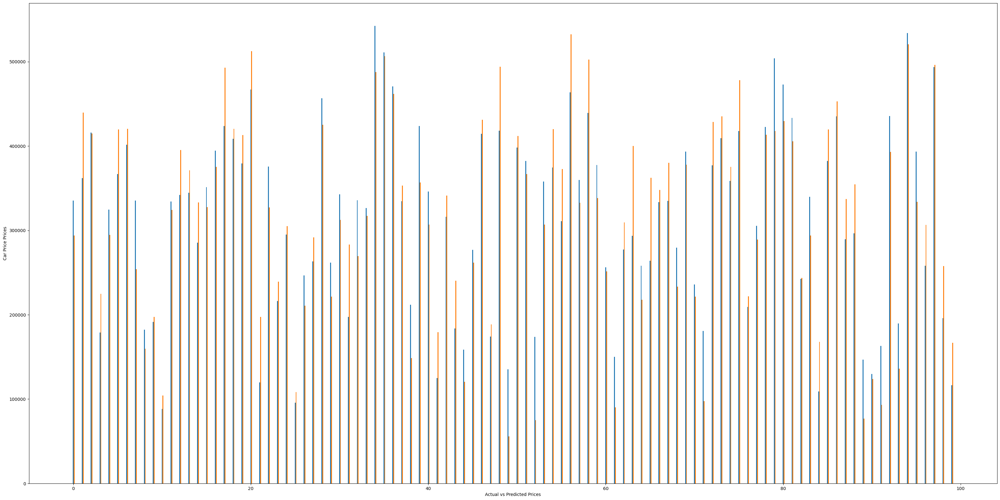

In [67]:
ind = np.arange(100)
plt.figure(figsize=(40,20))

width = 0.1

plt.bar(ind, y_pred, width, label='Predicted Car Price') #ind: This variable represents the positions on the x-axis where the bars will be placed.
plt.bar(ind + width, y_true, width, label='Actual Car Price')

plt.xlabel('Actual vs Predicted Prices')
plt.ylabel('Car Price Prices')

plt.show()

In [36]:
jovian.commit()

<IPython.core.display.Javascript object>

[jovian] Committed successfully! https://jovian.com/samirkhan993366/car-price-prediction


'https://jovian.com/samirkhan993366/car-price-prediction'